In [1]:
library("tidyverse")
library("data.table")
library("cowplot")

── Attaching core tidyverse packages ────
✔ dplyr     1.1.4     ✔ readr     2.1.5
✔ forcats   1.0.0     ✔ stringr   1.5.1
✔ ggplot2   3.5.1     ✔ tibble    3.2.1
✔ lubridate 1.9.3     ✔ tidyr     1.3.1
✔ purrr     1.0.2     
── Conflicts ─── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors

Attaching package: ‘data.table’


The following objects are masked from ‘package:lubridate’:

    hour, isoweek, mday, minute, month, quarter, second, wday, week,
    yday, year


The following objects are masked from ‘package:dplyr’:

    between, first, last


The following object is masked from ‘package:purrr’:

    transpose



Attaching package: ‘cowplot’


The following object is masked from ‘package:lubridate’:

    stamp




In [2]:
annot_df <- data.table(
    hmm_state_recoded = 1,
    distance = 1,
    angle = c(0, 90, -90, 180),
    label = c("0", "90", "-90", "±180")
)
annot_df

hmm_state_recoded,distance,angle,label
<dbl>,<dbl>,<dbl>,<chr>
1,1,0,0
1,1,90,90
1,1,-90,-90
1,1,180,±180


In [6]:
make_polar_plot <- function(n_states, time_step, seed = 1, n_points = 10000, nrow = 2){
    set.seed(seed)
    df <- fread(sprintf("/lts/research/birney/users/saul/nextflow/medaka_behaviour_pilot/hmm/time_step%s_n_states%s_hmm.csv.gz", time_step, n_states))
    df[, mean_dist := log10(mean(distance)), by = hmm_state]
    tmp <- df[, .(hmm_state, mean_dist)] |> distinct() |> as.data.table()
    tmp[, hmm_state_recoded := rank(mean_dist)]
    df <- merge(df, tmp, by = c("hmm_state", "mean_dist"))
    plt_df <- df[sample(1:.N, 10000)]
    remove(df)
    p <- ggplot() +
        geom_label(data = annot_df, aes(x = angle, y = distance, label = label), size = 5, label.size = NA) +
        geom_point(data = plt_df, aes(x = angle/pi*180, y = log10(distance)), size = 0.1) +
        coord_polar(start = pi) +
        scale_x_continuous(
            labels = c(),
            breaks = c(-90, 0, 90, 179.999) # cannot plot exactly 180
        ) +
        facet_wrap(~ hmm_state_recoded, nrow = nrow, labeller = as_labeller(function(i){sprintf("HMM state %s", i)})) +
        labs(x = "Angle (deg)", y = bquote(Distance~(Log[10](px)))) +
        theme_linedraw(18) +
        theme(
            legend.position = "none",
            panel.background = element_rect(fill = "white"),
            strip.background = element_blank(),
            strip.text = element_text(color = "black"),
            panel.grid.major = element_line(color = "gray30")
        ) +
        ggtitle("%s hidden states, %s seconds" |> sprintf(n_states, time_step))
    return(p)
}

# 5 states

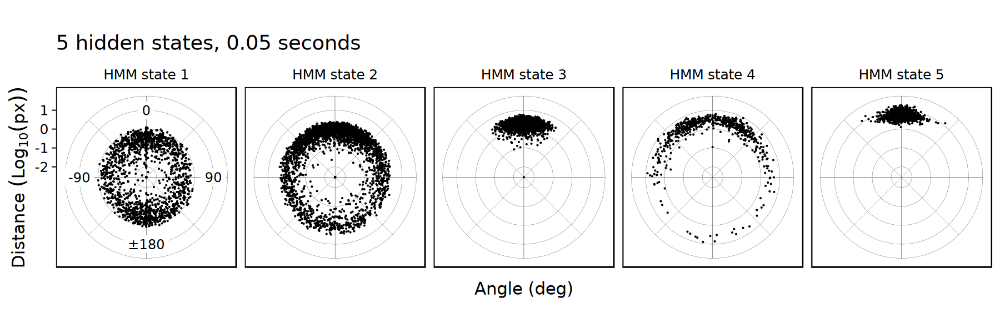

In [7]:
options(repr.plot.width = 15, repr.plot.height = 5)
make_polar_plot(5, 0.05, nrow = 1)

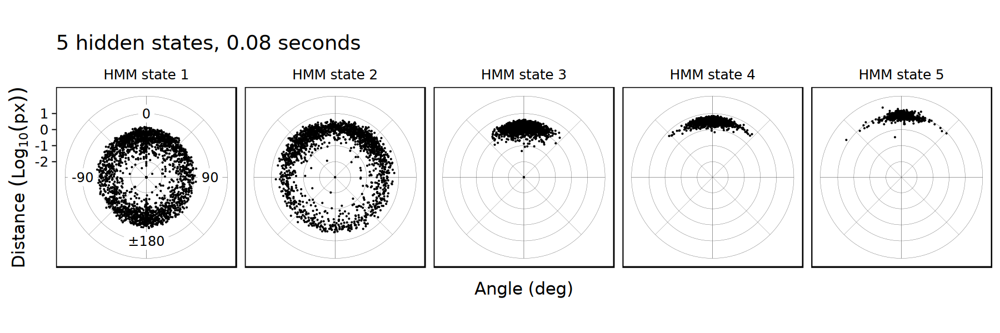

In [8]:
options(repr.plot.width = 15, repr.plot.height = 5)
make_polar_plot(5, 0.08, nrow = 1)

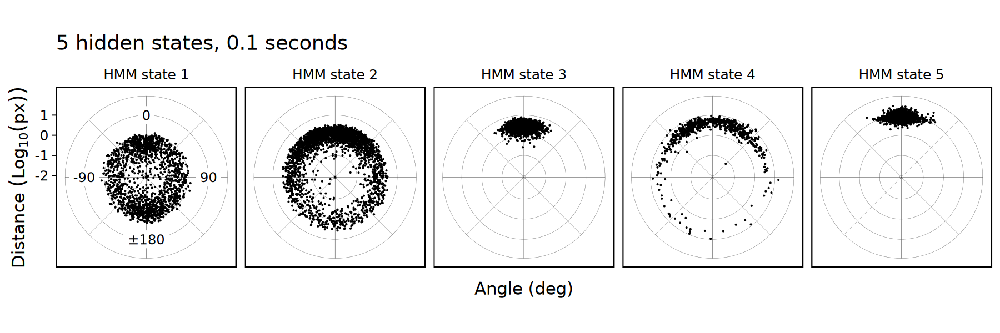

In [9]:
options(repr.plot.width = 15, repr.plot.height = 5)
make_polar_plot(5, 0.1, nrow = 1)

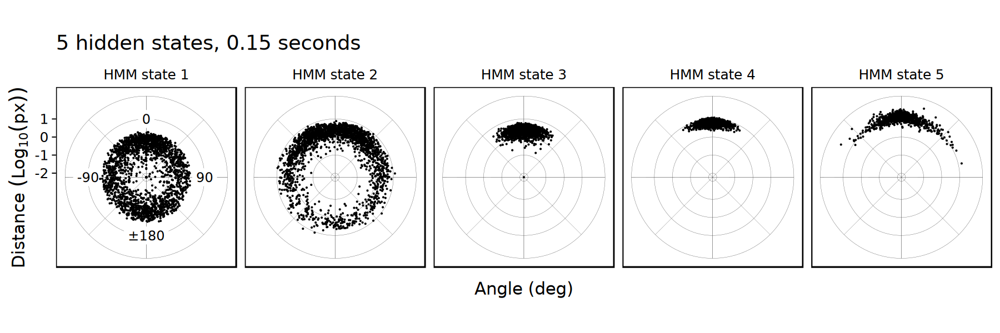

In [10]:
options(repr.plot.width = 15, repr.plot.height = 5)
make_polar_plot(5, 0.15, nrow = 1)

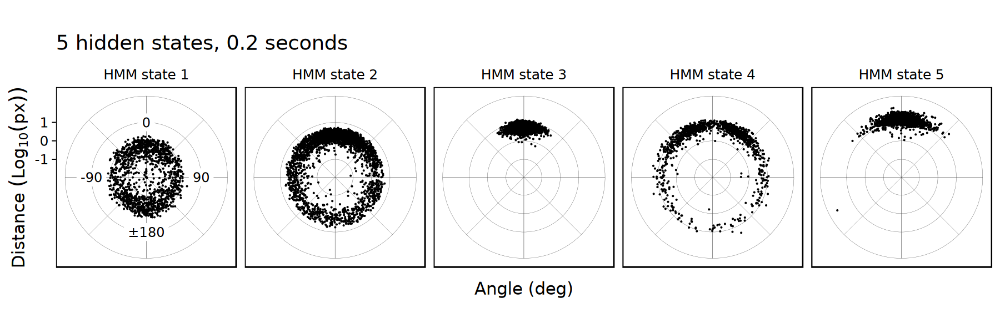

In [11]:
options(repr.plot.width = 15, repr.plot.height = 5)
make_polar_plot(5, 0.2, nrow = 1)

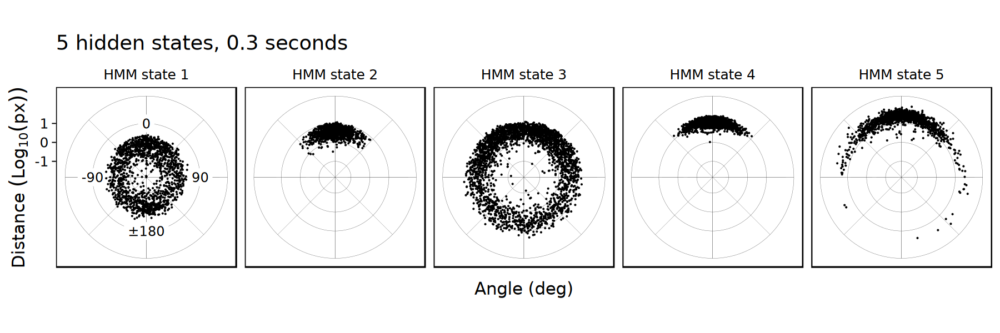

In [12]:
options(repr.plot.width = 15, repr.plot.height = 5)
make_polar_plot(5, 0.3, nrow = 1)

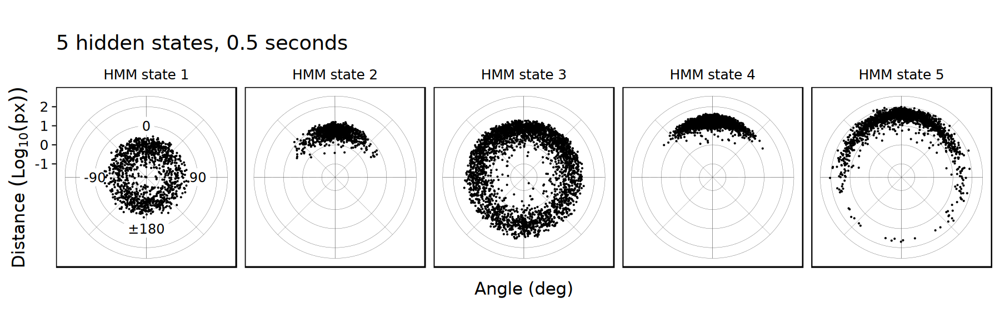

In [13]:
options(repr.plot.width = 15, repr.plot.height = 5)
make_polar_plot(5, 0.5, nrow = 1)

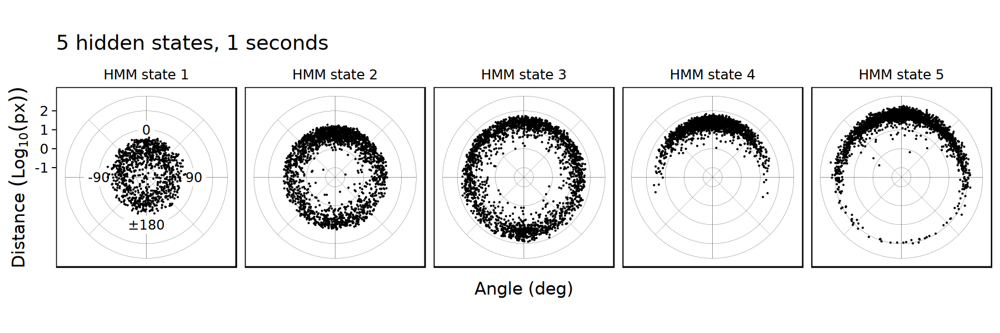

In [14]:
options(repr.plot.width = 15, repr.plot.height = 5)
make_polar_plot(5, 1, nrow = 1)

# 10 states

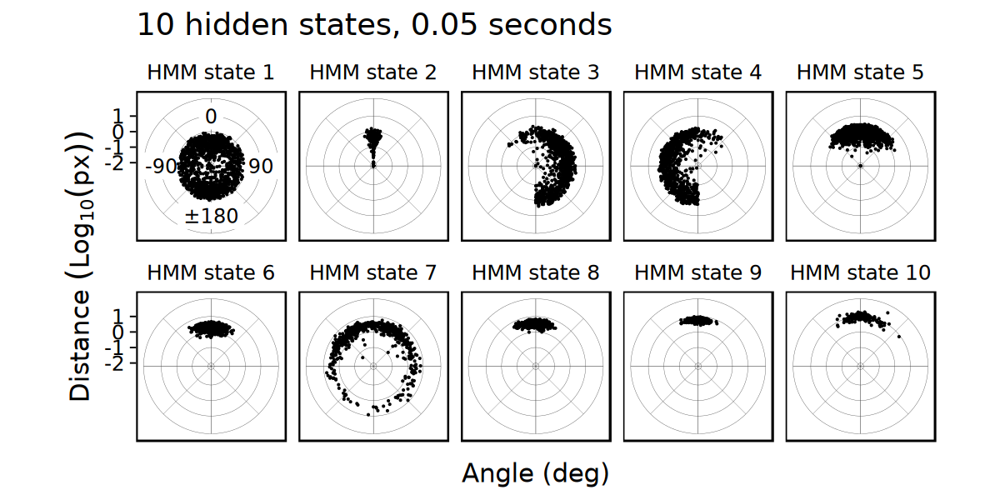

In [17]:
options(repr.plot.width = 10, repr.plot.height = 5)
make_polar_plot(10, 0.05, nrow = 2)

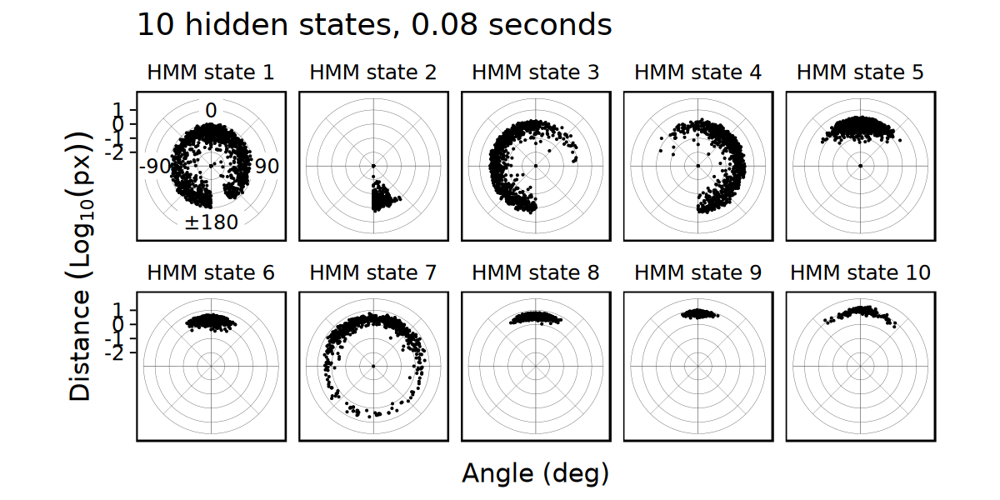

In [18]:
options(repr.plot.width = 10, repr.plot.height = 5)
make_polar_plot(10, 0.08, nrow = 2)

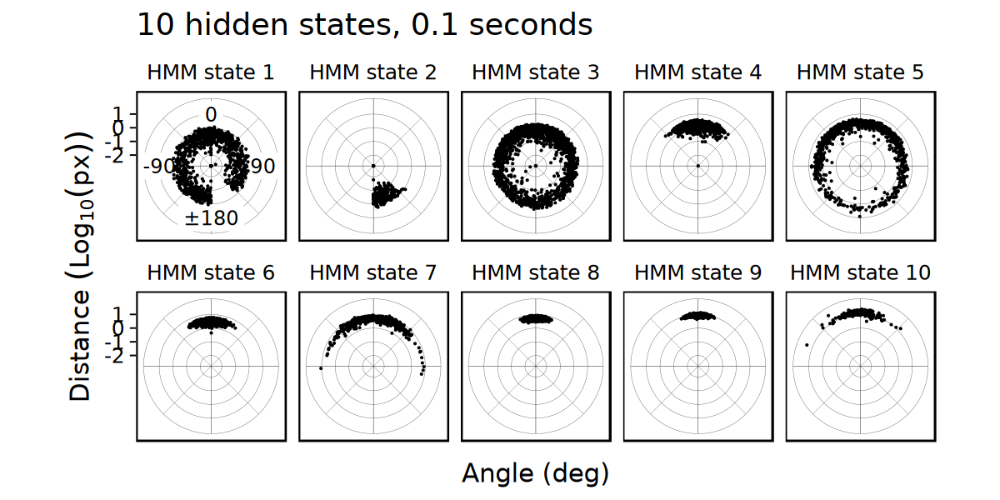

In [19]:
options(repr.plot.width = 10, repr.plot.height = 5)
make_polar_plot(10, 0.1, nrow = 2)

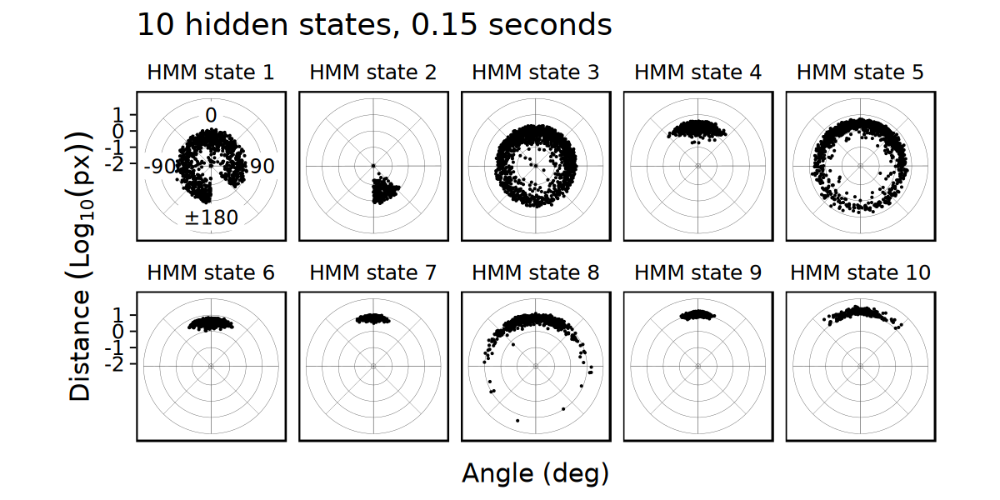

In [20]:
options(repr.plot.width = 10, repr.plot.height = 5)
make_polar_plot(10, 0.15, nrow = 2)

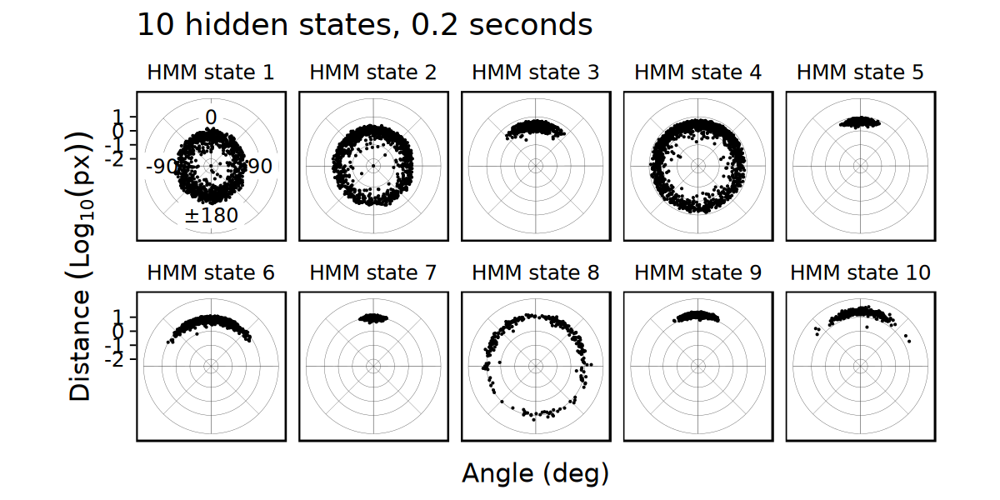

In [21]:
options(repr.plot.width = 10, repr.plot.height = 5)
make_polar_plot(10, 0.2, nrow = 2)

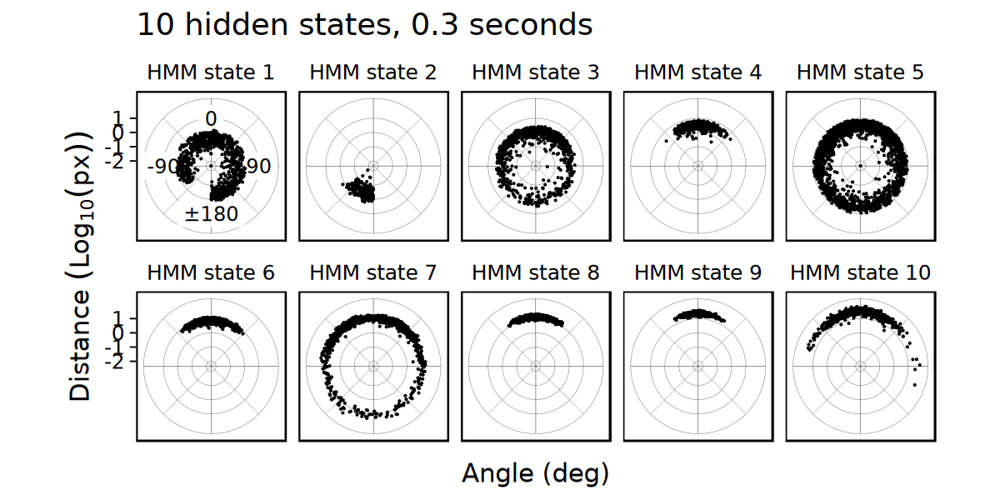

In [22]:
options(repr.plot.width = 10, repr.plot.height = 5)
make_polar_plot(10, 0.3, nrow = 2)

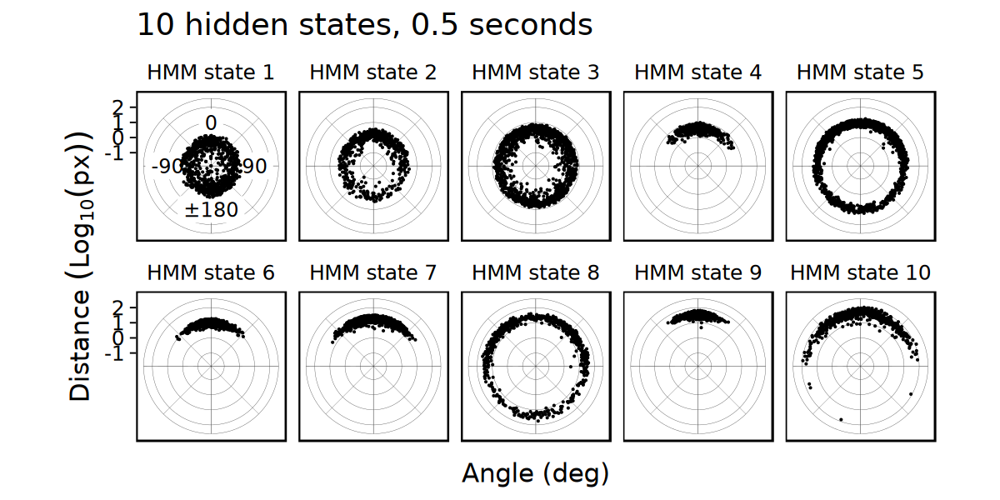

In [23]:
options(repr.plot.width = 10, repr.plot.height = 5)
make_polar_plot(10, 0.5, nrow = 2)

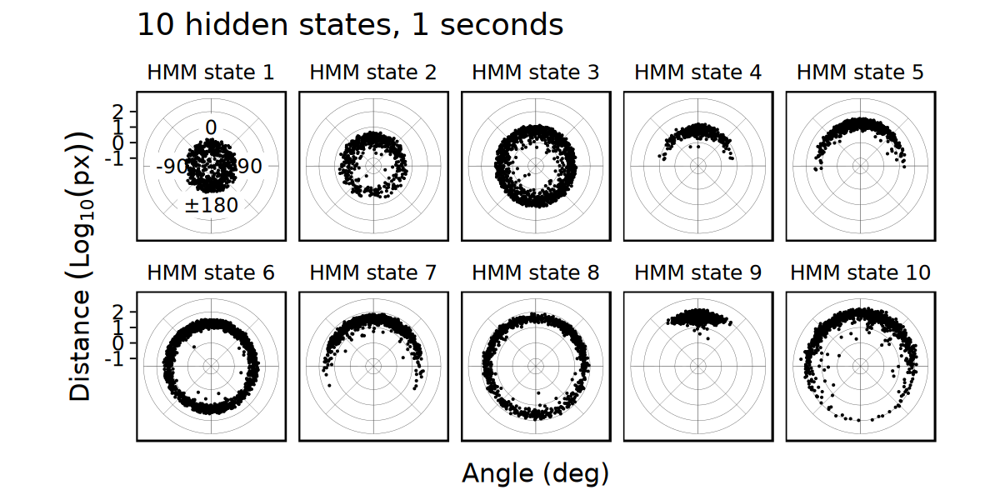

In [24]:
options(repr.plot.width = 10, repr.plot.height = 5)
make_polar_plot(10, 1, nrow = 2)

# 12 states

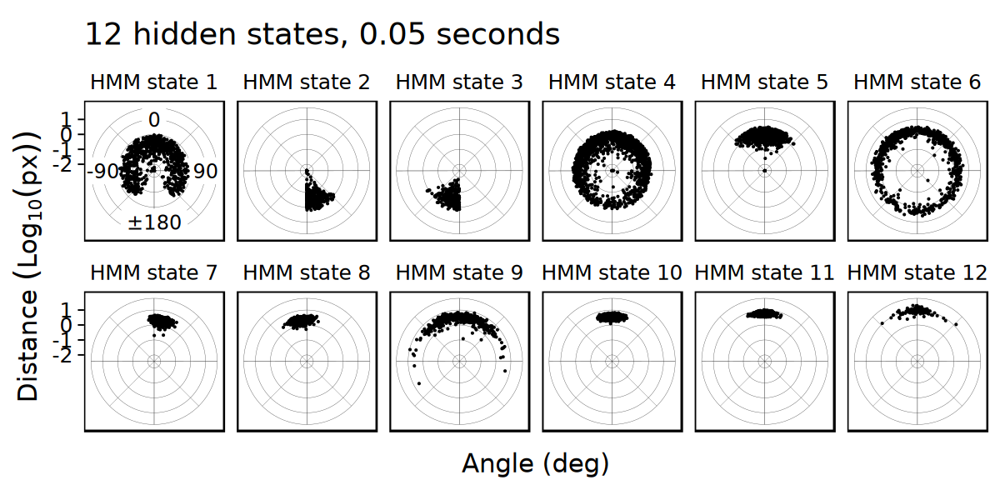

In [25]:
options(repr.plot.width = 10, repr.plot.height = 5)
make_polar_plot(12, 0.05, nrow = 2)

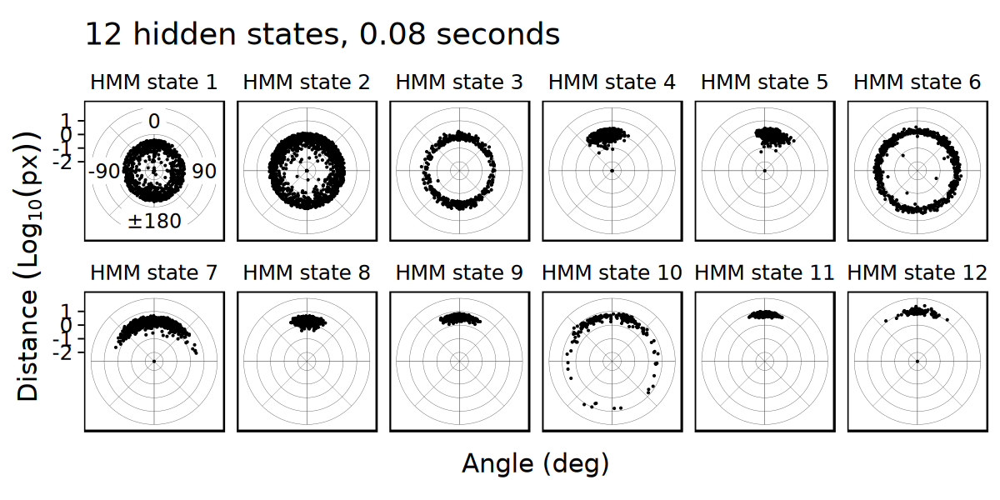

In [26]:
options(repr.plot.width = 10, repr.plot.height = 5)
make_polar_plot(12, 0.08, nrow = 2)

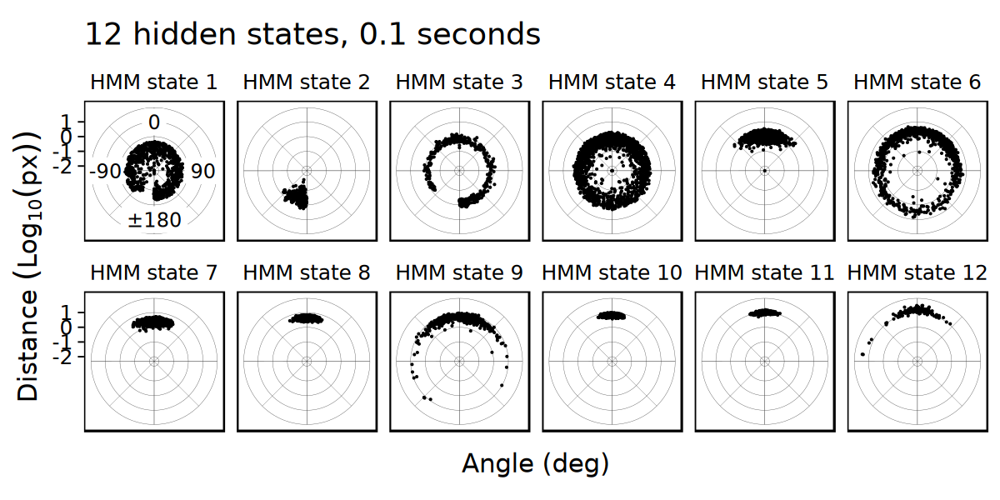

In [27]:
options(repr.plot.width = 10, repr.plot.height = 5)
make_polar_plot(12, 0.1, nrow = 2)

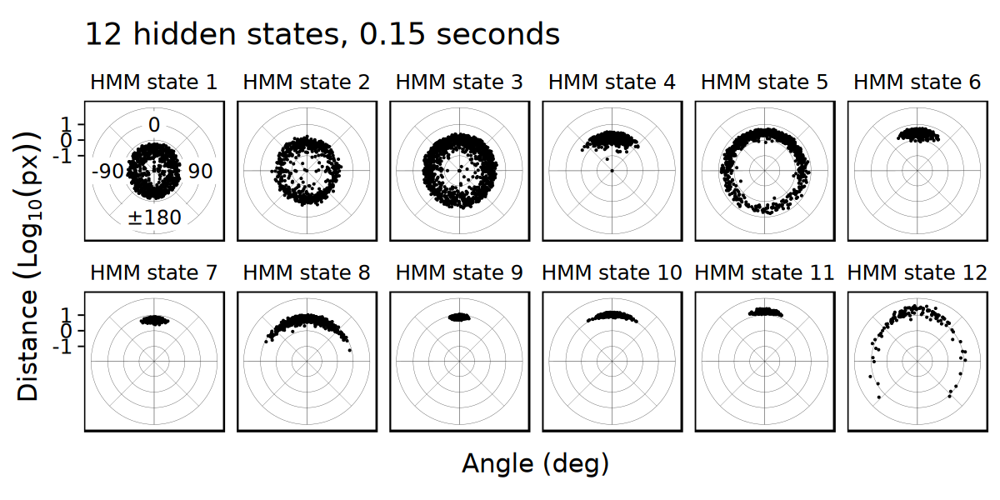

In [28]:
options(repr.plot.width = 10, repr.plot.height = 5)
make_polar_plot(12, 0.15, nrow = 2)

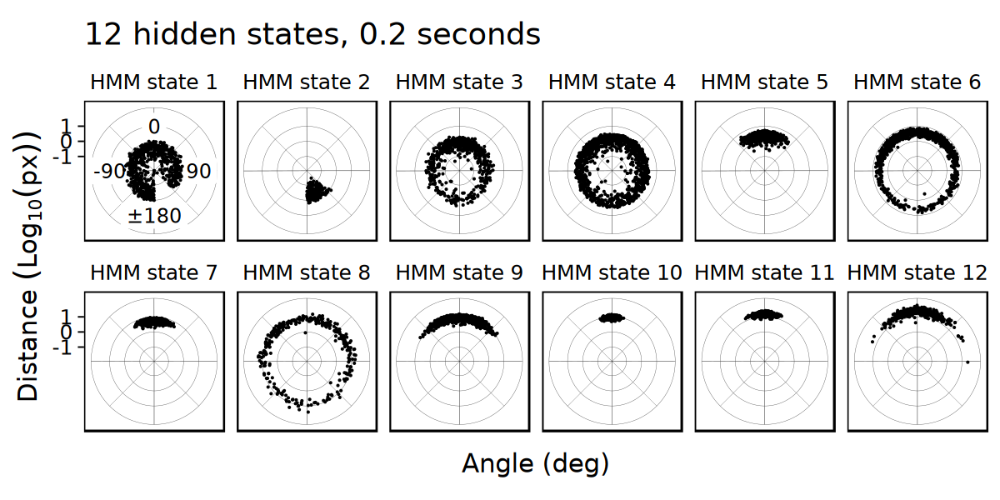

In [29]:
options(repr.plot.width = 10, repr.plot.height = 5)
make_polar_plot(12, 0.2, nrow = 2)

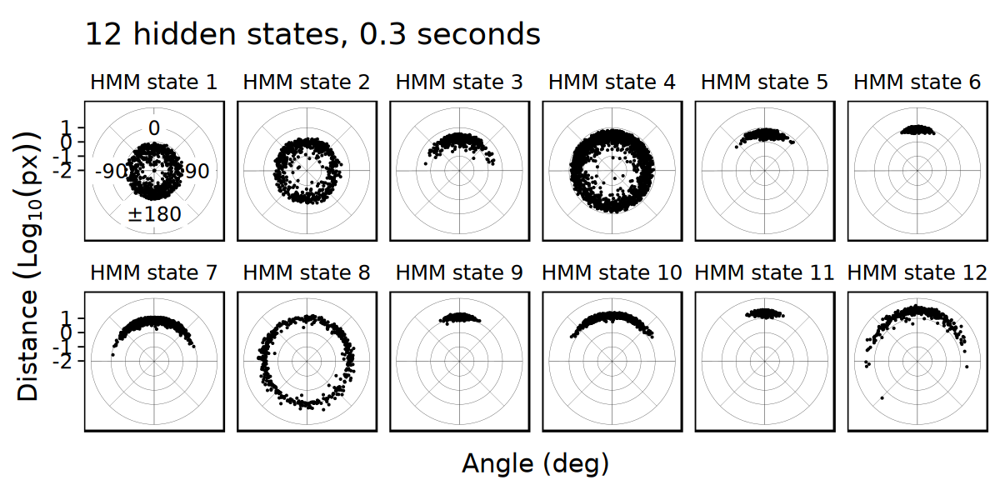

In [30]:
options(repr.plot.width = 10, repr.plot.height = 5)
make_polar_plot(12, 0.3, nrow = 2)

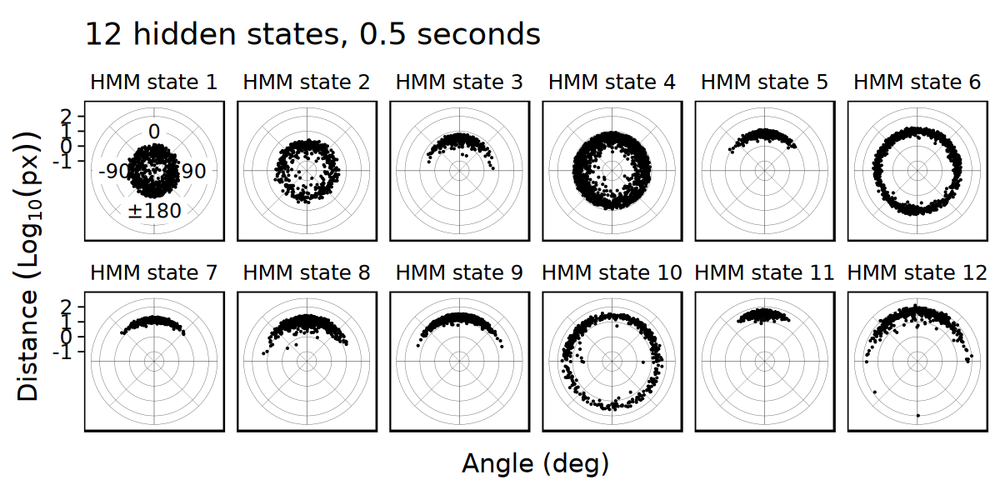

In [31]:
options(repr.plot.width = 10, repr.plot.height = 5)
make_polar_plot(12, 0.5, nrow = 2)

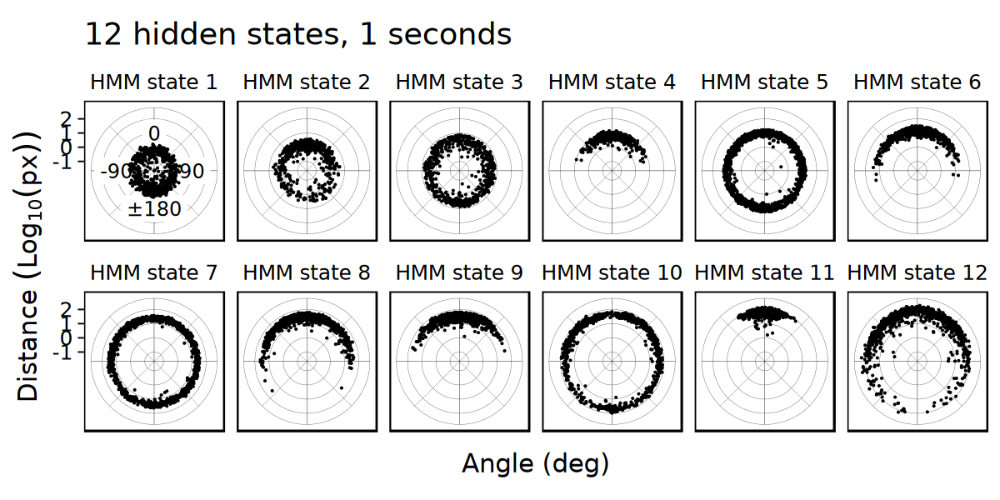

In [32]:
options(repr.plot.width = 10, repr.plot.height = 5)
make_polar_plot(12, 1, nrow = 2)

# 14 states

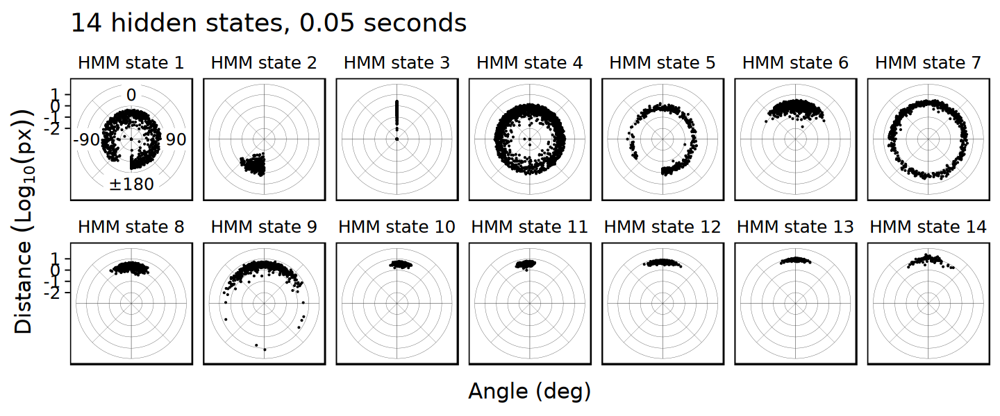

In [33]:
options(repr.plot.width = 12, repr.plot.height = 5)
make_polar_plot(14, 0.05, nrow = 2)

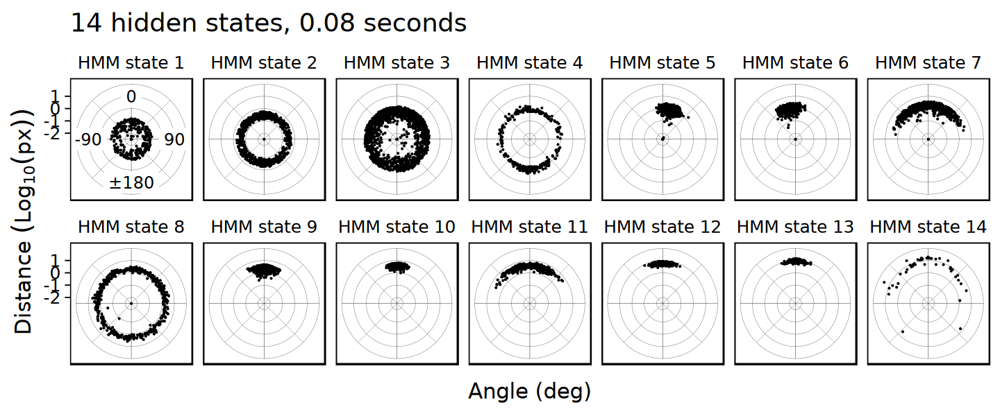

In [34]:
options(repr.plot.width = 12, repr.plot.height = 5)
make_polar_plot(14, 0.08, nrow = 2)

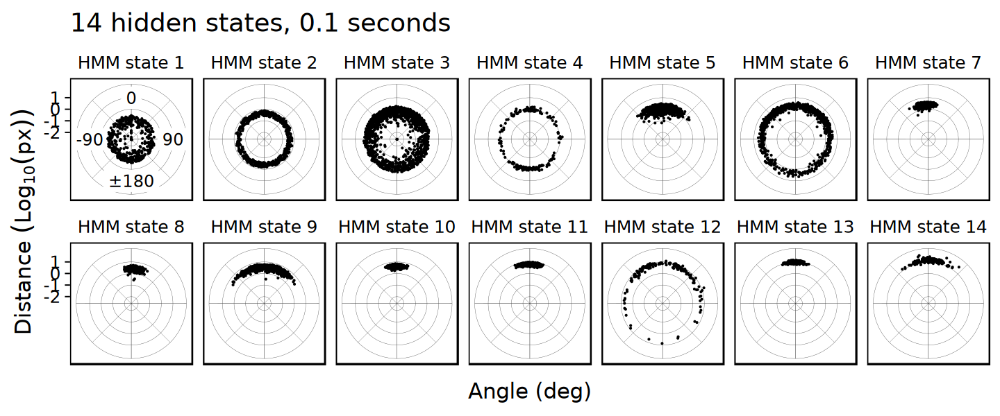

In [35]:
options(repr.plot.width = 12, repr.plot.height = 5)
make_polar_plot(14, 0.1, nrow = 2)

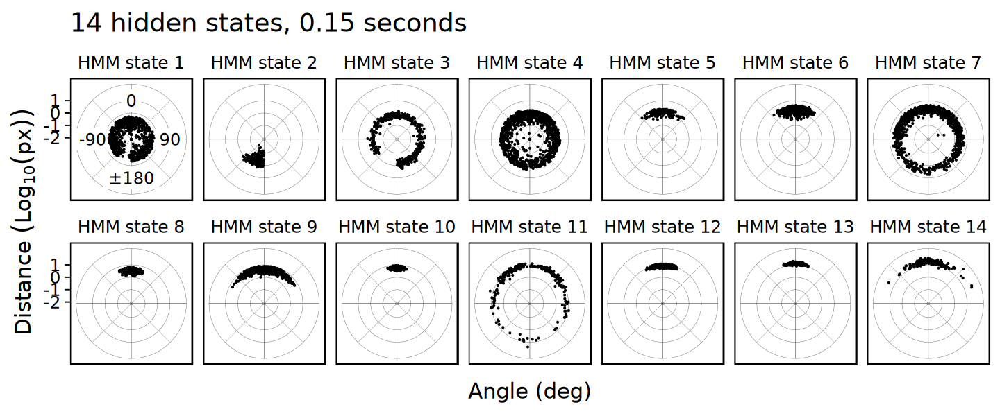

In [36]:
options(repr.plot.width = 12, repr.plot.height = 5)
make_polar_plot(14, 0.15, nrow = 2)

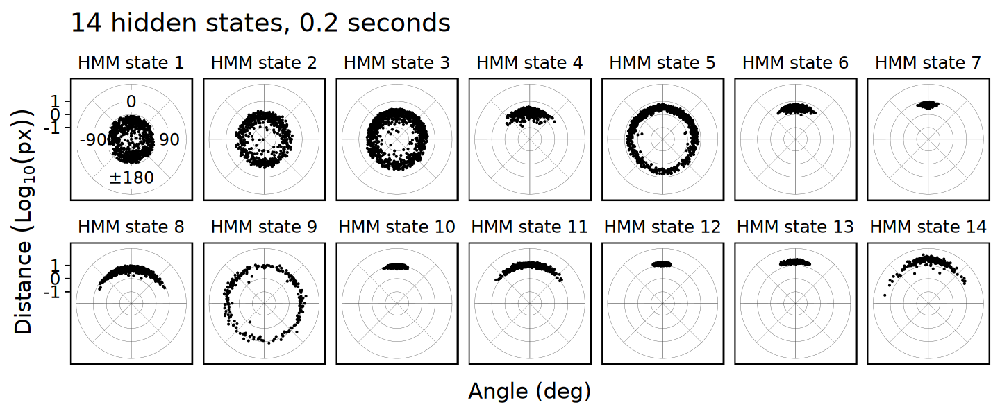

In [37]:
options(repr.plot.width = 12, repr.plot.height = 5)
make_polar_plot(14, 0.2, nrow = 2)

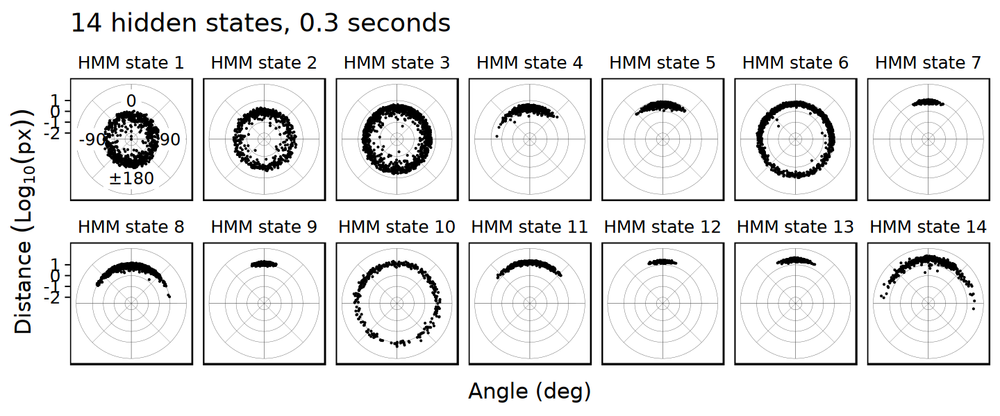

In [38]:
options(repr.plot.width = 12, repr.plot.height = 5)
make_polar_plot(14, 0.3, nrow = 2)

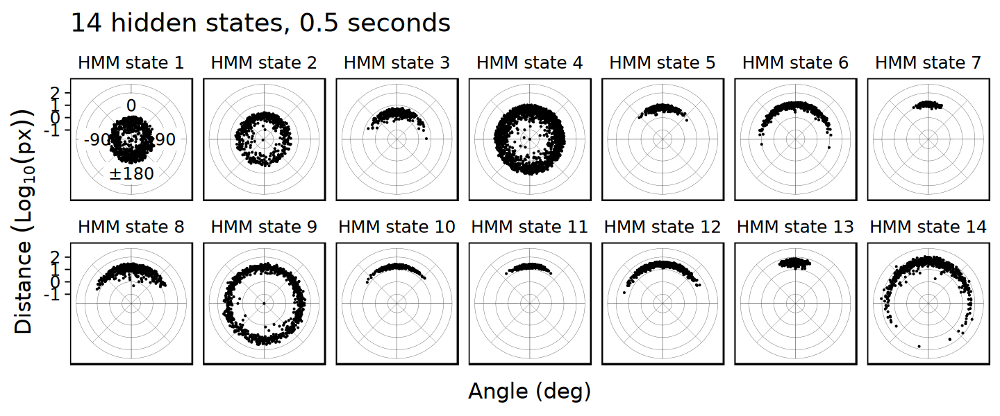

In [39]:
options(repr.plot.width = 12, repr.plot.height = 5)
make_polar_plot(14, 0.5, nrow = 2)

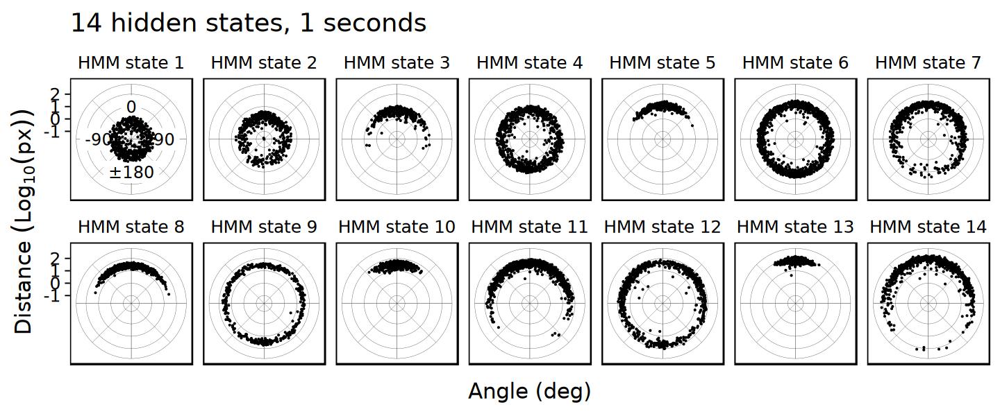

In [40]:
options(repr.plot.width = 12, repr.plot.height = 5)
make_polar_plot(14, 1, nrow = 2)

# 15 states

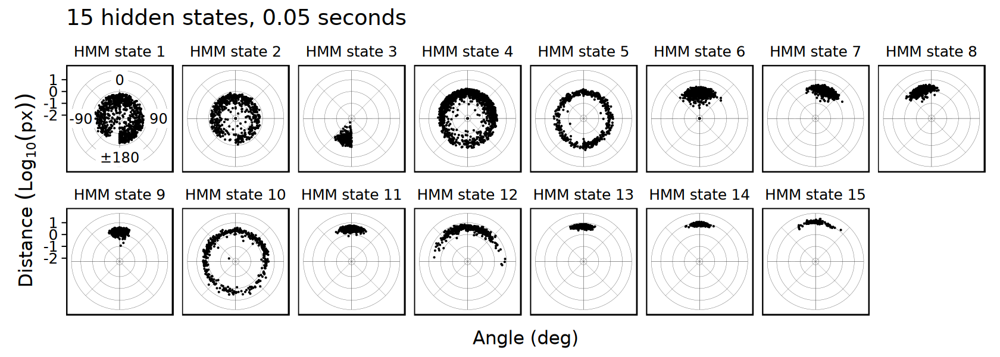

In [57]:
options(repr.plot.width = 14, repr.plot.height = 5)
make_polar_plot(15, 0.05, nrow = 2)

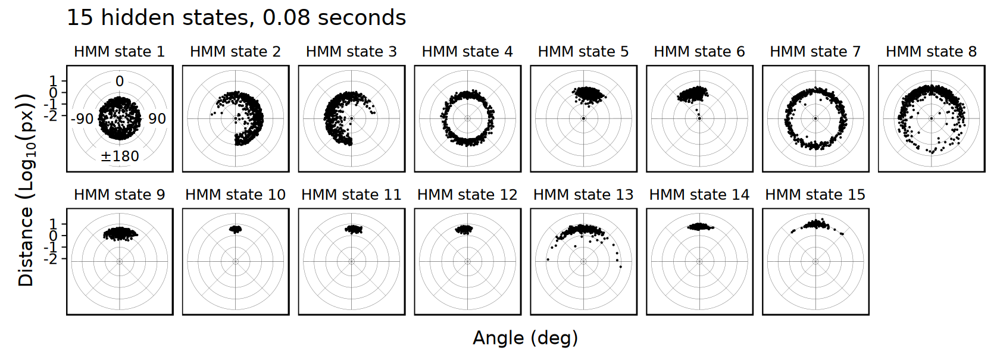

In [58]:
options(repr.plot.width = 14, repr.plot.height = 5)
make_polar_plot(15, 0.08, nrow = 2)

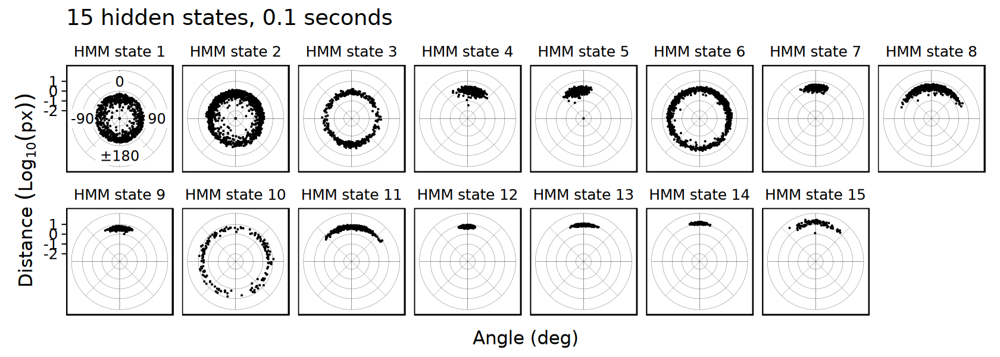

In [59]:
options(repr.plot.width = 14, repr.plot.height = 5)
make_polar_plot(15, 0.1, nrow = 2)

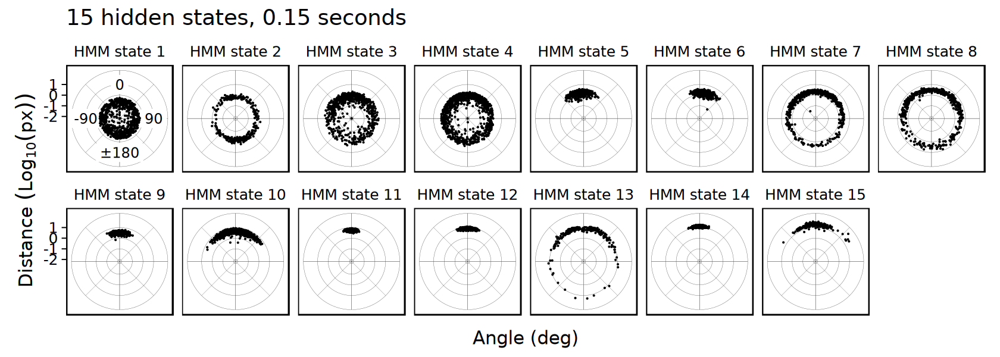

In [60]:
options(repr.plot.width = 14, repr.plot.height = 5)
make_polar_plot(15, 0.15, nrow = 2)

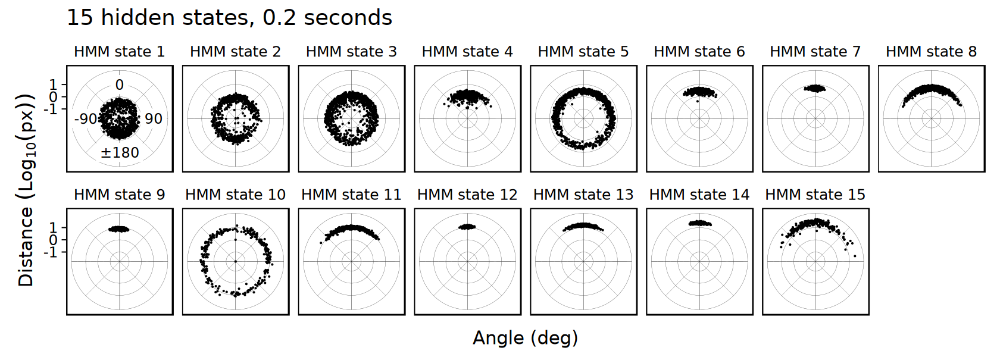

In [61]:
options(repr.plot.width = 14, repr.plot.height = 5)
make_polar_plot(15, 0.2, nrow = 2)

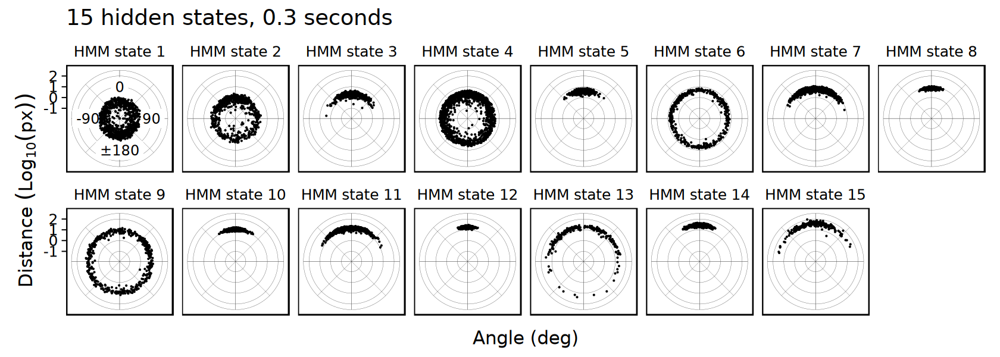

In [62]:
options(repr.plot.width = 14, repr.plot.height = 5)
make_polar_plot(15, 0.3, nrow = 2)

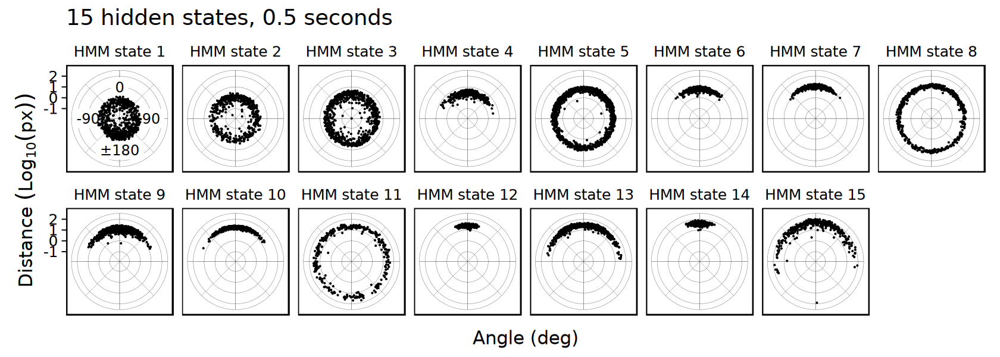

In [63]:
options(repr.plot.width = 14, repr.plot.height = 5)
make_polar_plot(15, 0.5, nrow = 2)

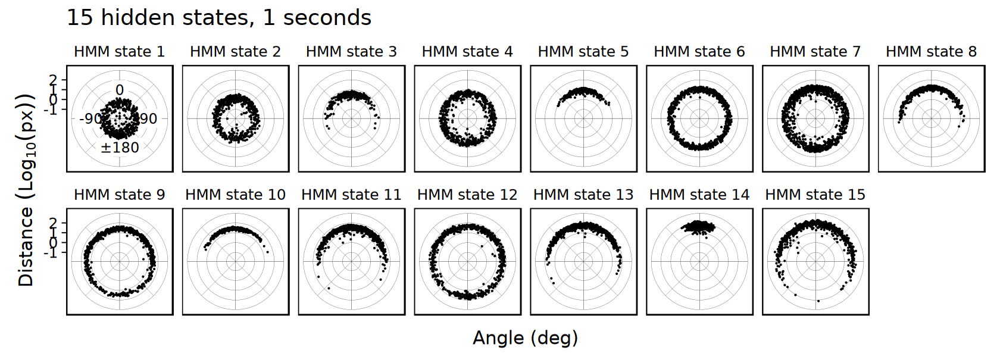

In [64]:
options(repr.plot.width = 14, repr.plot.height = 5)
make_polar_plot(15, 1, nrow = 2)

# 16 states

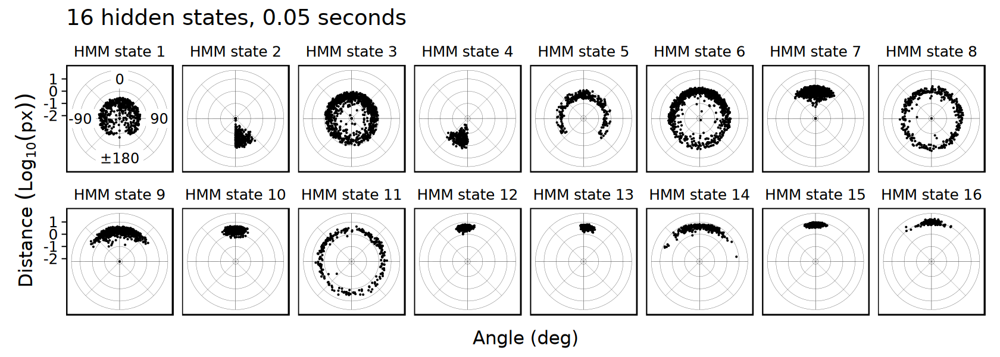

In [65]:
options(repr.plot.width = 14, repr.plot.height = 5)
make_polar_plot(16, 0.05, nrow = 2)

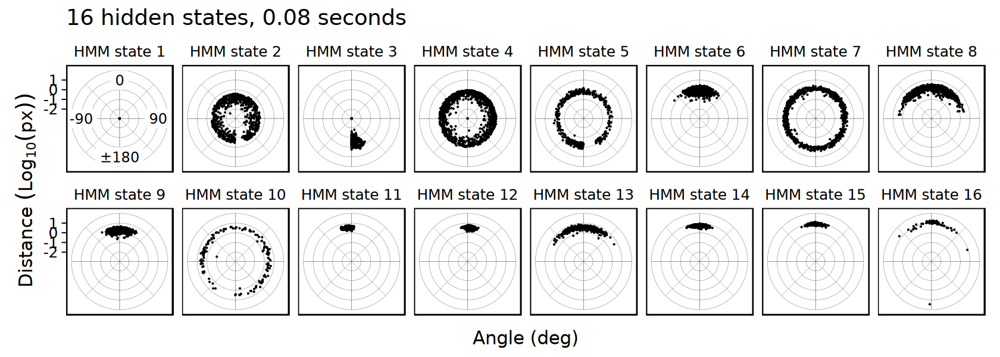

In [66]:
options(repr.plot.width = 14, repr.plot.height = 5)
make_polar_plot(16, 0.08, nrow = 2)

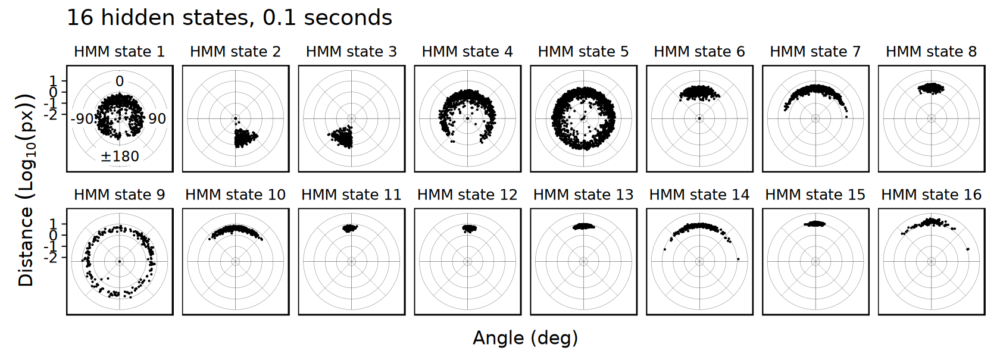

In [68]:
options(repr.plot.width = 14, repr.plot.height = 5)
make_polar_plot(16, 0.1, nrow = 2)

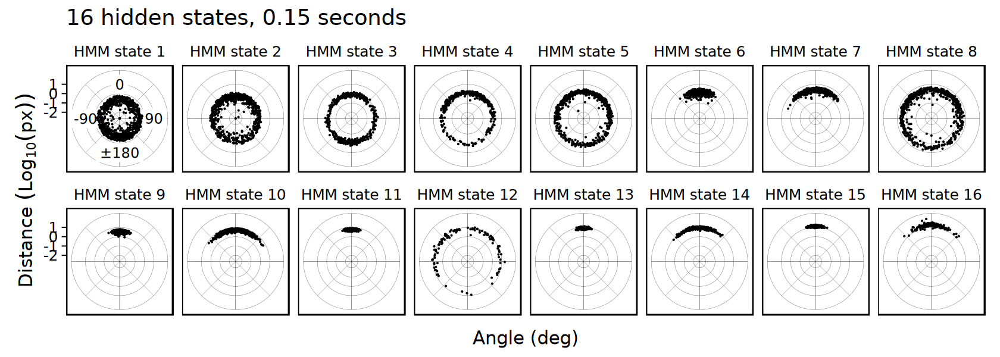

In [69]:
options(repr.plot.width = 14, repr.plot.height = 5)
make_polar_plot(16, 0.15, nrow = 2)

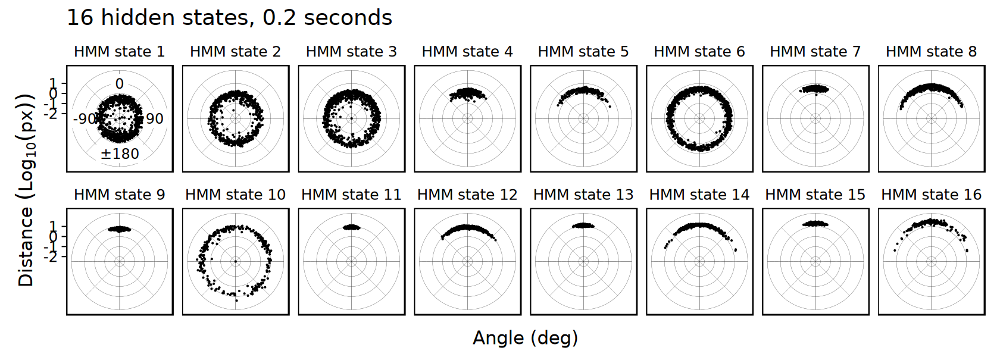

In [70]:
options(repr.plot.width = 14, repr.plot.height = 5)
make_polar_plot(16, 0.2, nrow = 2)

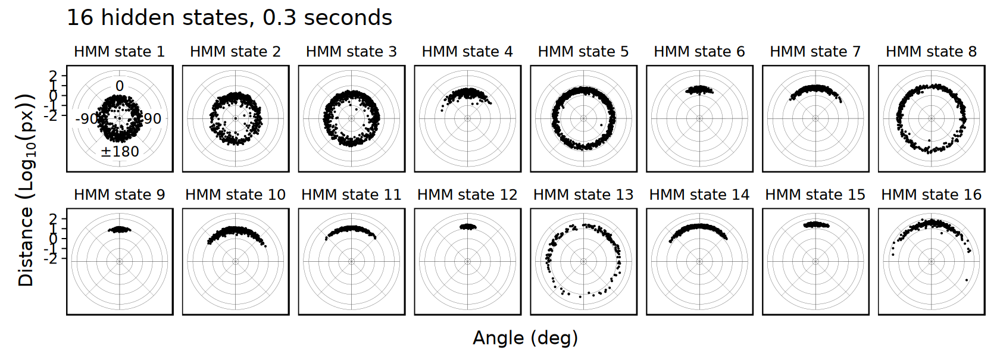

In [71]:
options(repr.plot.width = 14, repr.plot.height = 5)
make_polar_plot(16, 0.3, nrow = 2)

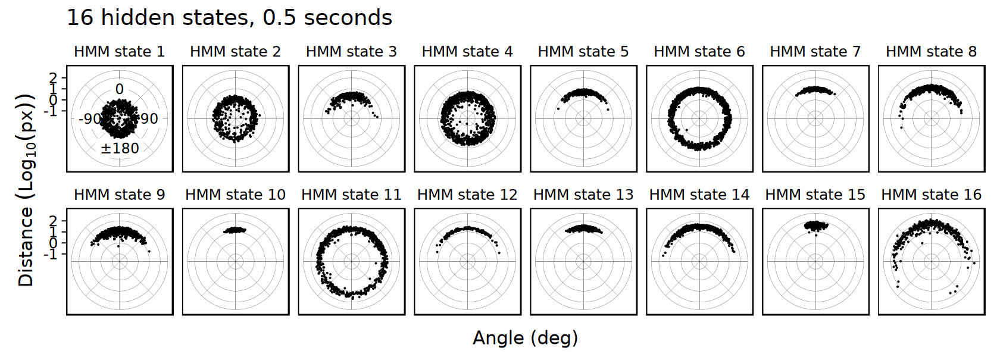

In [72]:
options(repr.plot.width = 14, repr.plot.height = 5)
make_polar_plot(16, 0.5, nrow = 2)

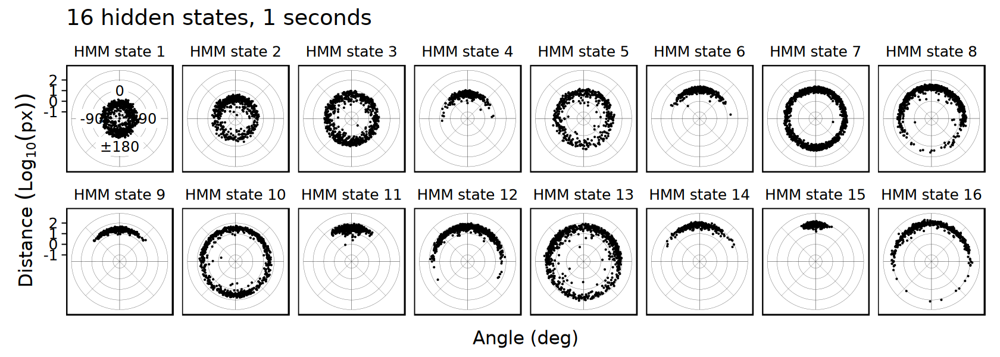

In [73]:
options(repr.plot.width = 14, repr.plot.height = 5)
make_polar_plot(16, 1, nrow = 2)

# 17 states

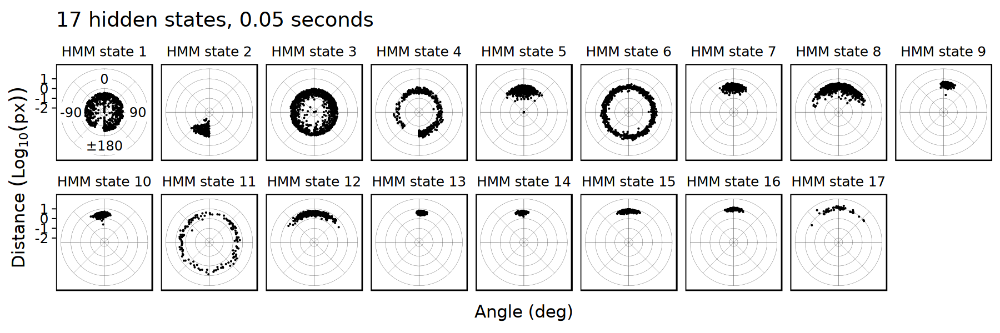

In [75]:
options(repr.plot.width = 15, repr.plot.height = 5)
make_polar_plot(17, 0.05, nrow = 2)

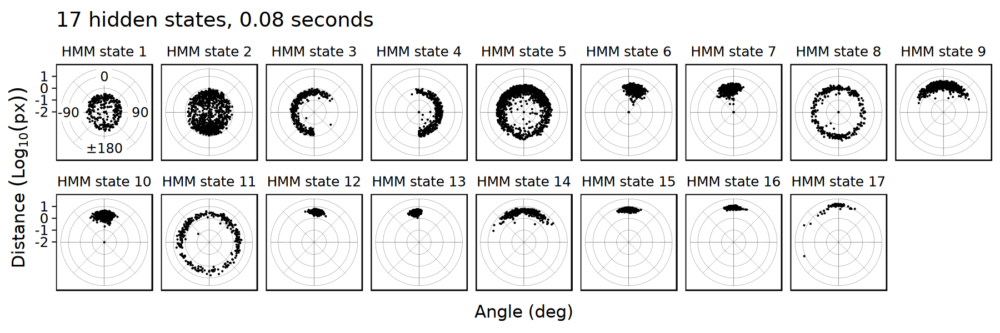

In [79]:
options(repr.plot.width = 15, repr.plot.height = 5)
make_polar_plot(17, 0.08, nrow = 2)

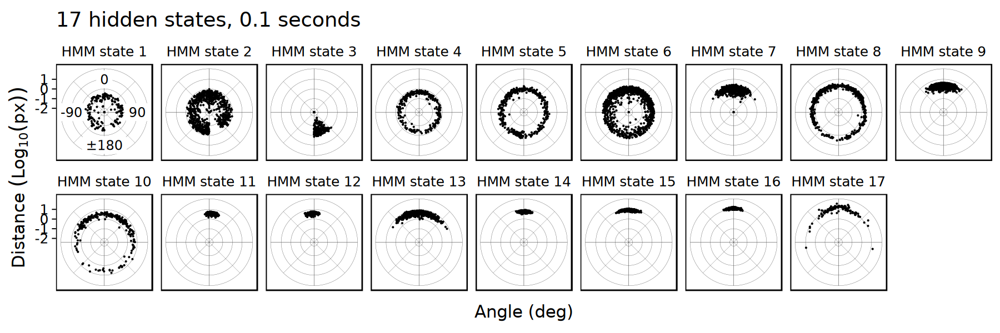

In [80]:
options(repr.plot.width = 15, repr.plot.height = 5)
make_polar_plot(17, 0.1, nrow = 2)

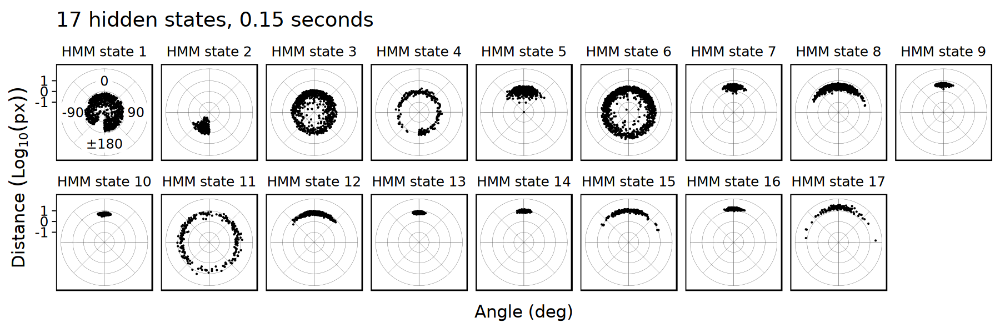

In [81]:
options(repr.plot.width = 15, repr.plot.height = 5)
make_polar_plot(17, 0.15, nrow = 2)

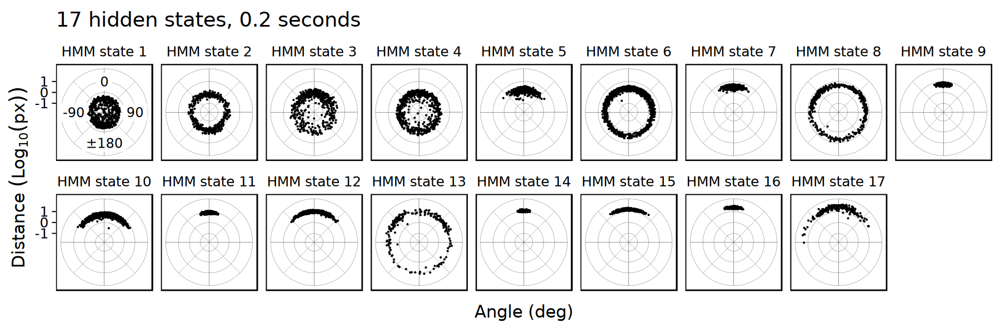

In [82]:
options(repr.plot.width = 15, repr.plot.height = 5)
make_polar_plot(17, 0.2, nrow = 2)

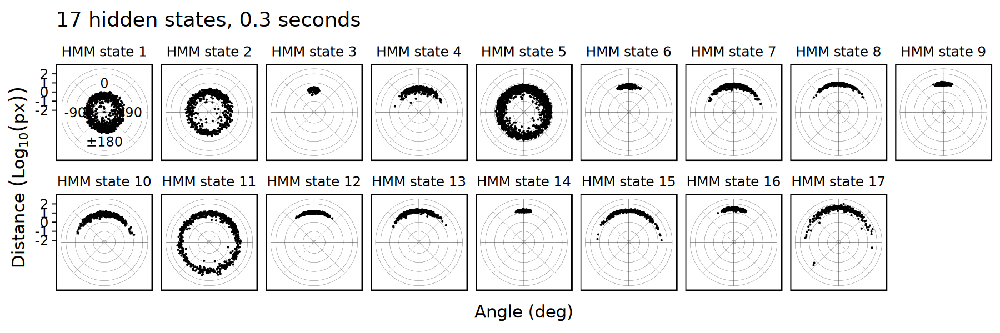

In [84]:
options(repr.plot.width = 15, repr.plot.height = 5)
make_polar_plot(17, 0.3, nrow = 2)

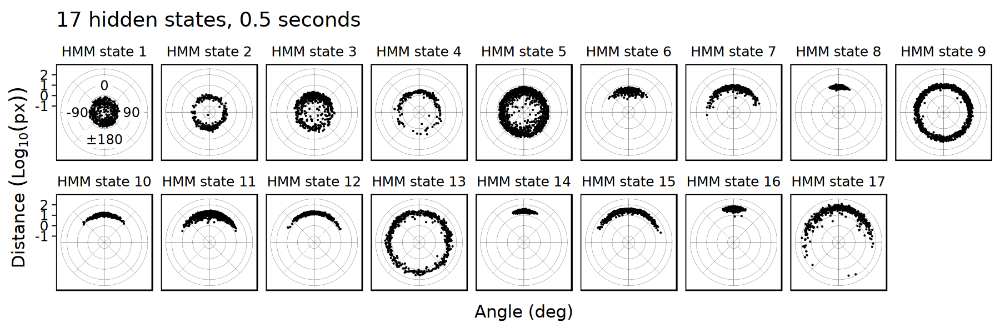

In [85]:
options(repr.plot.width = 15, repr.plot.height = 5)
make_polar_plot(17, 0.5, nrow = 2)

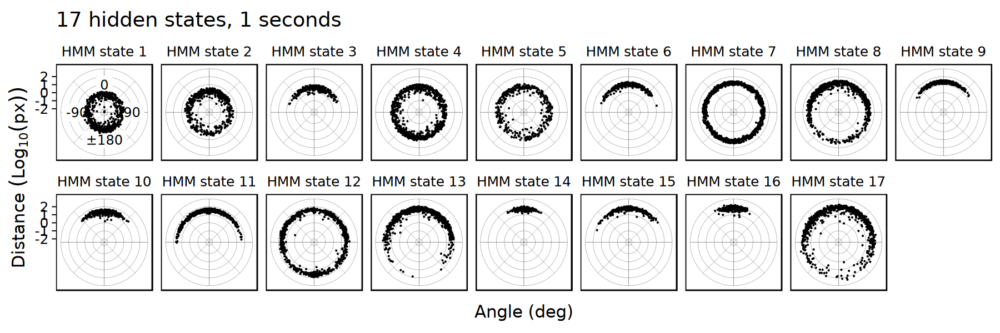

In [86]:
options(repr.plot.width = 15, repr.plot.height = 5)
make_polar_plot(17, 1, nrow = 2)

# 18 states

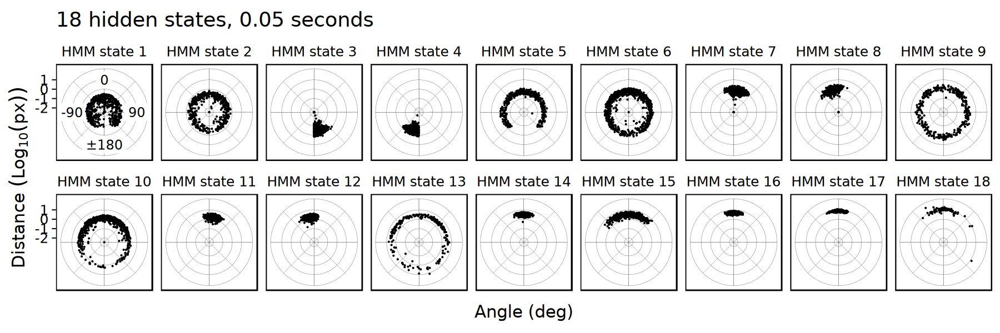

In [87]:
options(repr.plot.width = 15, repr.plot.height = 5)
make_polar_plot(18, 0.05, nrow = 2)

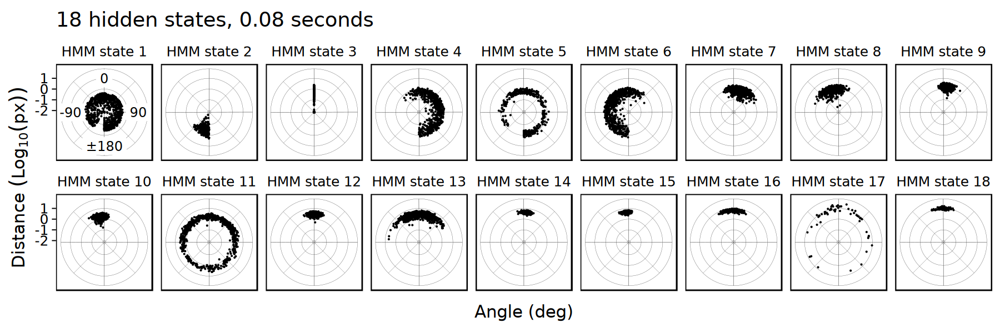

In [94]:
options(repr.plot.width = 15, repr.plot.height = 5)
make_polar_plot(18, 0.08, nrow = 2)

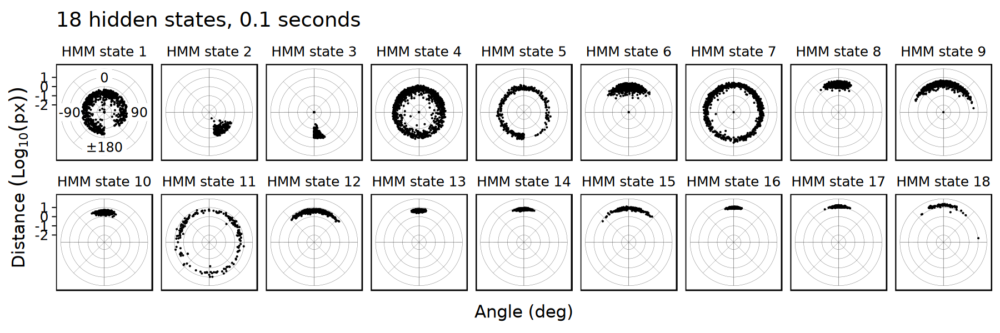

In [88]:
options(repr.plot.width = 15, repr.plot.height = 5)
make_polar_plot(18, 0.1, nrow = 2)

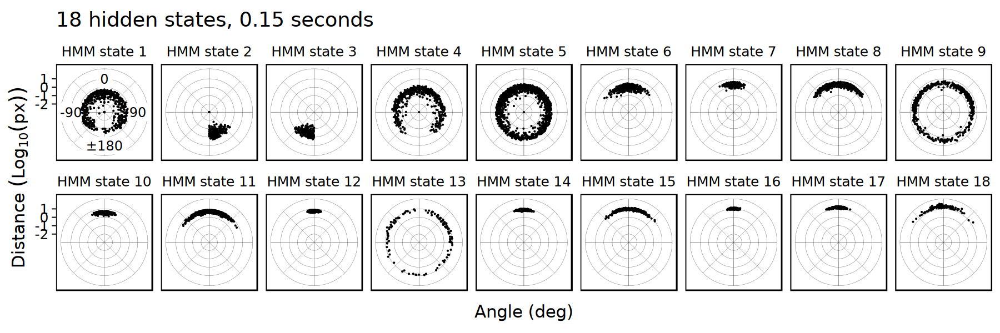

In [89]:
options(repr.plot.width = 15, repr.plot.height = 5)
make_polar_plot(18, 0.15, nrow = 2)

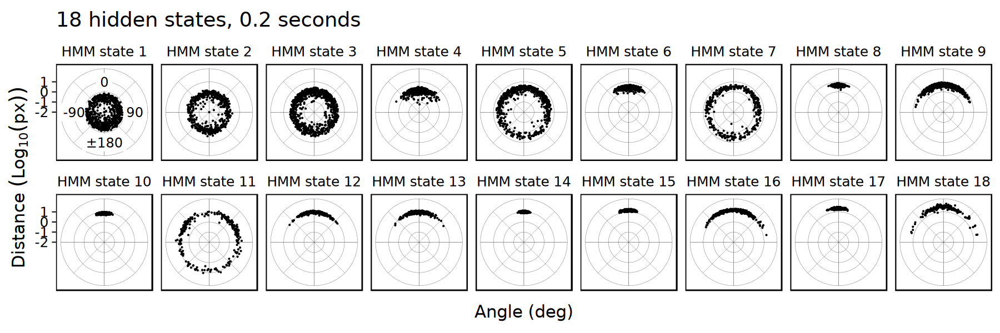

In [90]:
options(repr.plot.width = 15, repr.plot.height = 5)
make_polar_plot(18, 0.2, nrow = 2)

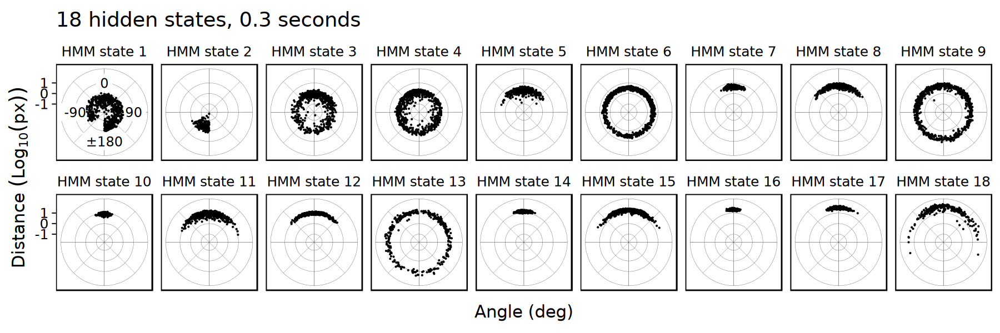

In [91]:
options(repr.plot.width = 15, repr.plot.height = 5)
make_polar_plot(18, 0.3, nrow = 2)

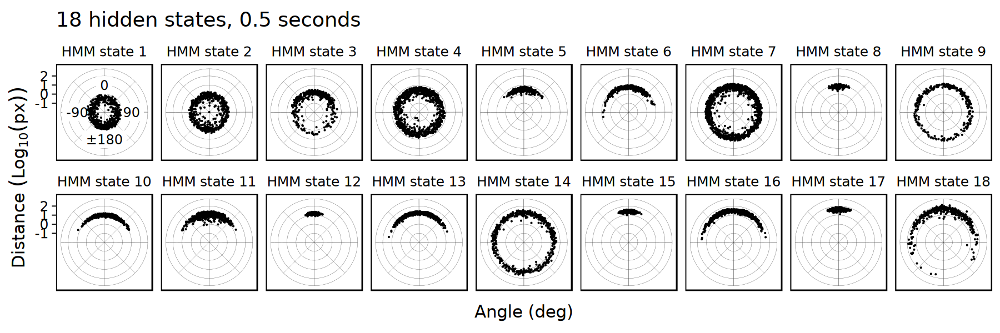

In [92]:
options(repr.plot.width = 15, repr.plot.height = 5)
make_polar_plot(18, 0.5, nrow = 2)

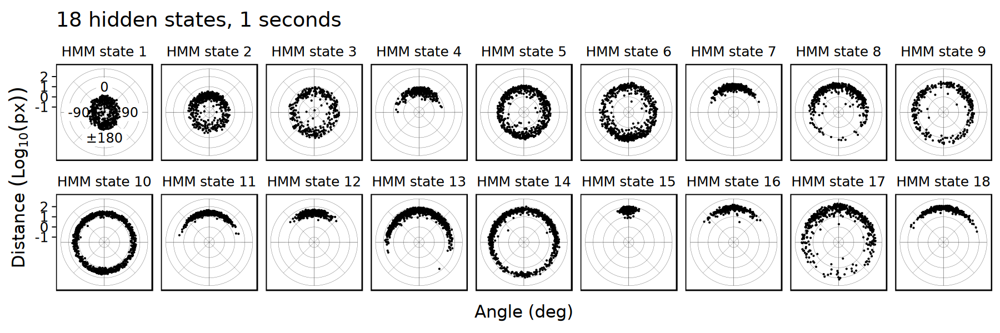

In [95]:
options(repr.plot.width = 15, repr.plot.height = 5)
make_polar_plot(18, 1, nrow = 2)

# 20 states

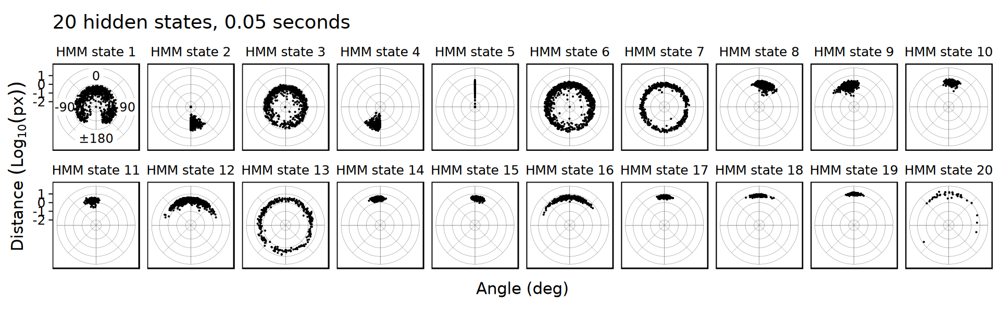

In [96]:
options(repr.plot.width = 16, repr.plot.height = 5)
make_polar_plot(20, 0.05, nrow = 2)

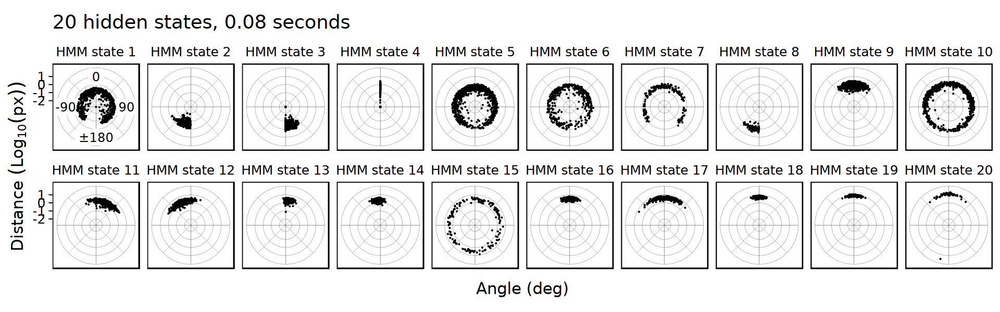

In [97]:
options(repr.plot.width = 16, repr.plot.height = 5)
make_polar_plot(20, 0.08, nrow = 2)

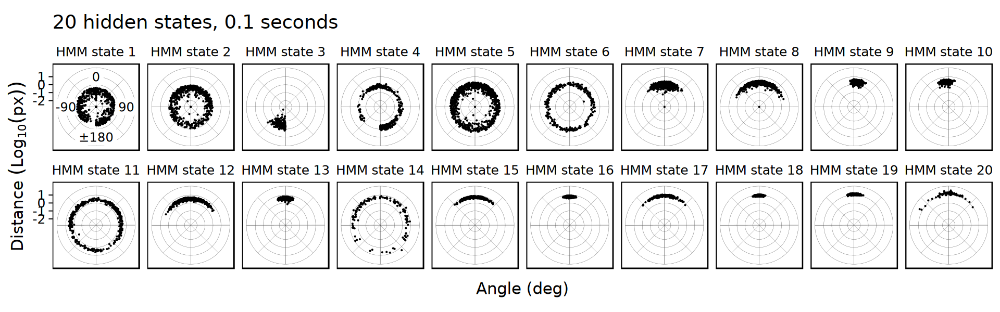

In [98]:
options(repr.plot.width = 16, repr.plot.height = 5)
make_polar_plot(20, 0.1, nrow = 2)

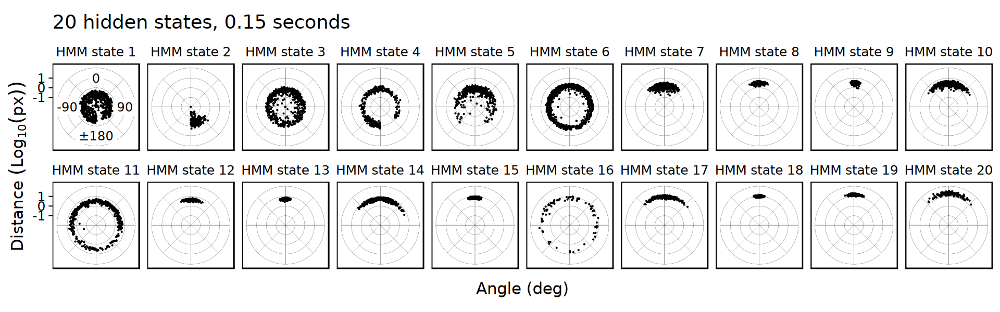

In [99]:
options(repr.plot.width = 16, repr.plot.height = 5)
make_polar_plot(20, 0.15, nrow = 2)

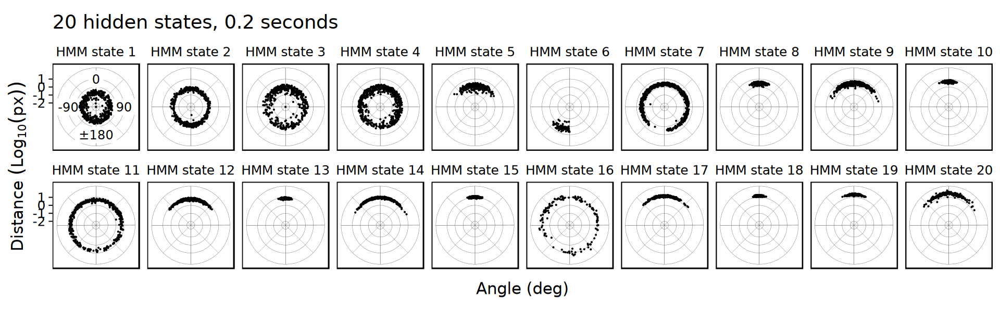

In [100]:
options(repr.plot.width = 16, repr.plot.height = 5)
make_polar_plot(20, 0.2, nrow = 2)

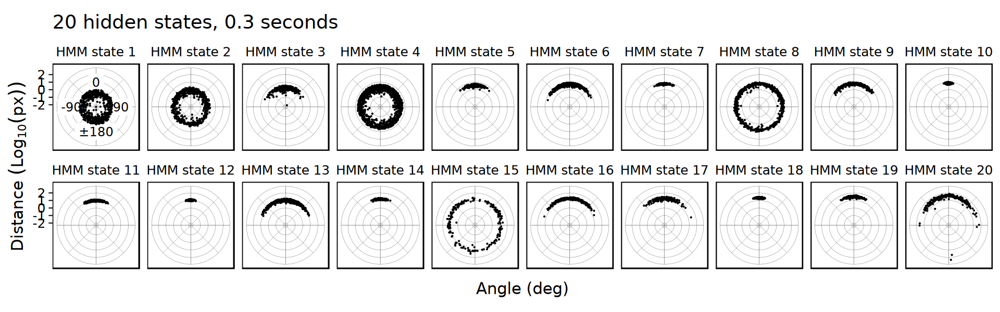

In [101]:
options(repr.plot.width = 16, repr.plot.height = 5)
make_polar_plot(20, 0.3, nrow = 2)

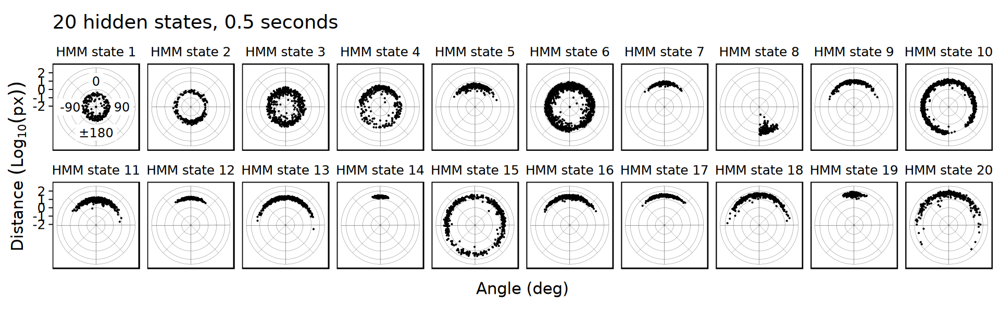

In [102]:
options(repr.plot.width = 16, repr.plot.height = 5)
make_polar_plot(20, 0.5, nrow = 2)

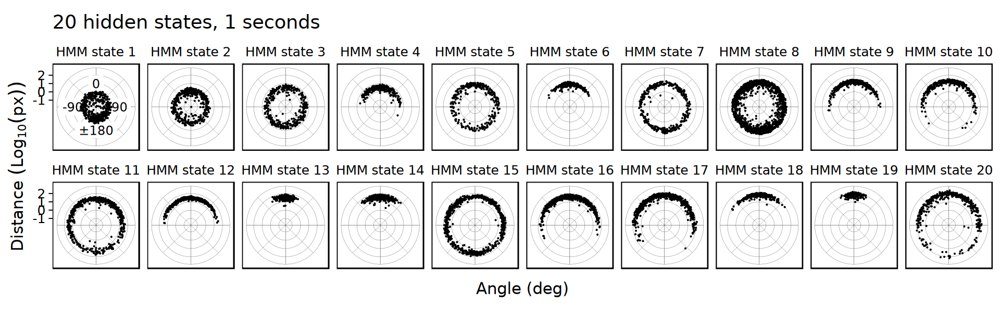

In [103]:
options(repr.plot.width = 16, repr.plot.height = 5)
make_polar_plot(20, 1, nrow = 2)